## Passo 0 - Importando bibliotecas

In [1]:
# Pacotes padrao
import os
import pickle
import itertools
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy import stats
from datetime import datetime
import seaborn as sns


#Pipeline
from sklearn.pipeline import Pipeline

#Tratamento
from sklearn.decomposition import PCA
from sklearn.preprocessing import PolynomialFeatures
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler

#sisidentpy
from sysidentpy.model_structure_selection import FROLS
from sysidentpy.basis_function._basis_function import Polynomial, Fourier
from sysidentpy.utils.narmax_tools import regressor_code

#Modelos
from sklearn.linear_model import LinearRegression, Ridge, ElasticNet
from sklearn.svm import SVR
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor, ExtraTreesRegressor, AdaBoostRegressor, BaggingRegressor
from sklearn.ensemble import StackingRegressor, VotingRegressor
from sklearn.neural_network import MLPRegressor
import lightgbm as lgb
import xgboost as xgb

#Interface SYSID
from SYSIDPreProcessor import SYSIDRegressor

#Busca de modelos
from sklearn.model_selection import RandomizedSearchCV, RepeatedKFold

# Scores
from sklearn.metrics import r2_score, mean_squared_error

# Disabling warnings
import warnings
warnings.filterwarnings('ignore')


from sklearn.exceptions import DataConversionWarning


#Definindo random_state
rs = 85

# copiando sidmodel porque ele não estava escrevendo a ordem correta dos modelos
from copy import copy, deepcopy

import scienceplots
plt.style.use(['science', 'ieee', 'notebook'])

c:\Users\bewm\AppData\Roaming\Python\env\env2\lib\site-packages\tqdm\auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## Passo 0 - Importando os dados

recovering from picke, comment if not necessary

In [2]:
# prefix = 'ENSV5B.MISO.W1'
# binary = os.path.join(os.getcwd(), 'outputs', f'{prefix}_ml.pkl')
# print(binary)

# with open(binary, 'rb') as bin_file:
#     X1_tr, y_tr, X1_te, y_te, order_progression2, df = pickle.load(bin_file)   

c:\Users\bewm\Documents\Projetos\Mestrado\SYSID_Trabalho\Volve-Dataset\outputs\ENSV5B.MISO.W1_ml.pkl


### 0.1 - Lendo dados

In [3]:
binary = os.path.join(os.getcwd(), 'data', 'volve_compiled.pkl')
print(binary)

with open(binary, 'rb') as bin_file:
    data = pickle.load(bin_file)

c:\Users\bewm\Documents\Projetos\Mestrado\SYSID_Trabalho\Volve-Dataset\data\volve_compiled.pkl


In [4]:
for wellp in data['OP'].keys():
    print(wellp)

15/9-F-1 C
15/9-F-11
15/9-F-12
15/9-F-14
15/9-F-15 D
15/9-F-5


### 0.2 - Selecionando dados

In [5]:
case = "15/9-F-1 C"
# case = "15/9-F-15 D"
#case = "15/9-F-11"

data_case = data['OP'][case]

filt_vars_IN_Q =  [
        #'BORE_OIL_VOL',
        #'BORE_GAS_VOL',
        #'BORE_WAT_VOL',
        #'BORE_OIL_CUM',
        #'BORE_LIQ_CUM',
        #'BORE_GAS_CUM',
        #'BORE_WAT_CUM',
]

filt_vars_IN_QINJ = [
        'BORE_WI_VOL',
        'BORE_WI_CUM',
]

filt_vars_IN_P = [
        'AVG_DOWNHOLE_PRESSURE',
        'AVG_WHP_P',
        #'AVG_DP_TUBING',
        #'AVG_ANNULUS_PRESS',
        'AVG_CHOKE_SIZE_P',
        #'DP_CHOKE_SIZE',
]

filt_vars_IN_T = [
        'AVG_WHT_P',
        'AVG_DOWNHOLE_TEMPERATURE',
]

filt_vars_OUT = [
        #'BORE_OIL_VOL',
        'BORE_LIQ_VOL',
        #'BORE_GAS_VOL',
        #'BORE_WAT_VOL',
]


Plotando dados

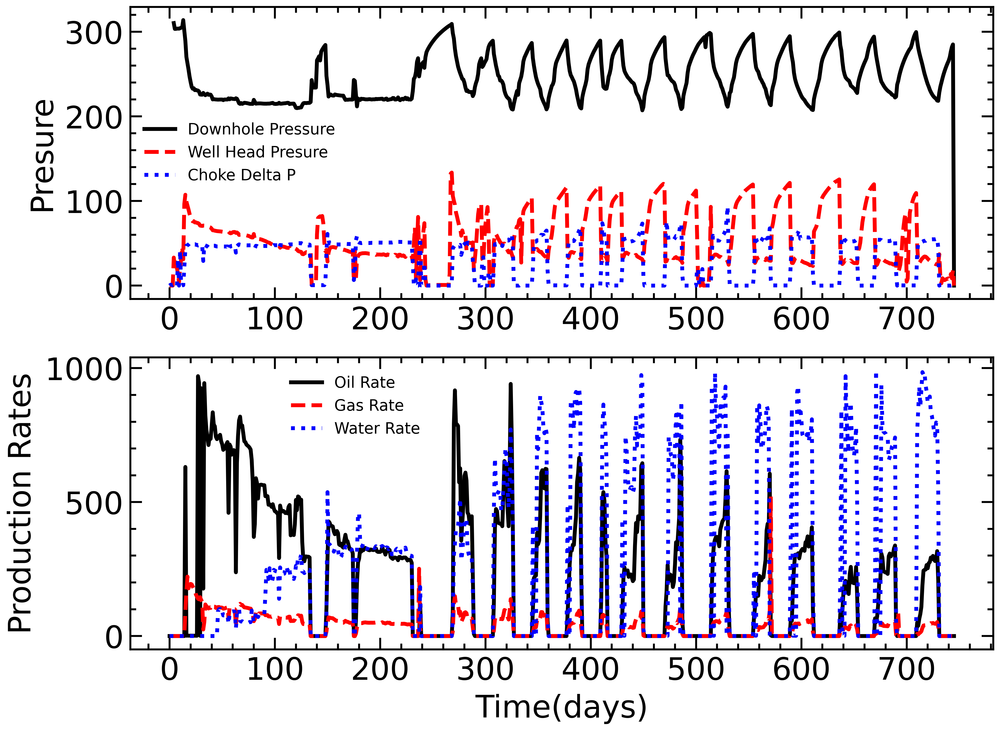

In [6]:
time = data_case['N']

plot_dict_1 = {
'AVG_DOWNHOLE_PRESSURE':'Downhole Pressure',
'AVG_WHP_P':'Well Head Presure',
# 'AVG_DP_TUBING':'Tubing Delta P',
# 'AVG_ANNULUS_PRESS':'Annulus Pressure',
'AVG_CHOKE_SIZE_P':'Choke Delta P',
# 'DP_CHOKE_SIZE':'DP_CHOKE_SIZE_P',
}
plot_dict_T = {
'AVG_DOWNHOLE_TEMPERATURE':'Downhole Temperature',
'AVG_WHT_P':'Well Head Temperature',
}
plot_dict_2 = {
'BORE_OIL_VOL':'Oil Rate',
'BORE_GAS_VOL':'Gas Rate',
'BORE_WAT_VOL':'Water Rate',
}

fig, ax = plt.subplots(2,1, figsize=(8,6))

for k,v in plot_dict_1.items():
    ax[0].plot(time, data_case[k], label=v)
# for k,v in plot_dict_T.items():
#     ax[1].plot(time, data_case[k], label=v)
for k,v in plot_dict_2.items():
    ax[1].plot(time, data_case[k], label=v)

ax[0].legend(fontsize='8')
# ax[0].set_xlabel('Time(days)')
ax[0].set_ylabel('Presure')
ax[1].legend(fontsize='8', bbox_to_anchor=(.17,.68))
ax[1].set_xlabel('Time(days)')
ax[1].set_ylabel('Production Rates')
# ax[2].legend(fontsize='8')


p = os.path.join(os.getcwd(), 'outputs', 'images_ensembles', '0_well_data.eps')
fig.savefig(p, format='eps')
pass;


In [143]:
data_case = data_case.iloc[28:,:]
#data_case = data_case[data_case['AVG_DOWNHOLE_PRESSURE']>0]
data_case = data_case[filt_vars_IN_Q + filt_vars_IN_P + filt_vars_IN_T + filt_vars_OUT].dropna()
X1 = data_case[filt_vars_IN_Q + filt_vars_IN_P + filt_vars_IN_T].values
y =  data_case[filt_vars_OUT].values

## Passo 1 - Separando os dados em treino e teste

### 1.1 - Definindo a parcela de treino e de teste

In [144]:
p_train = 0.7 #70% treino

### 1.2 - Separando os conjuntos

In [145]:
n_train = int(X1.shape[0]*p_train)
X1_tr = X1[:n_train,:]
y_tr = y[:n_train,:]
X1_te = X1[:,:]
y_te = y[:,:]

In [146]:
print(
    X1_tr.shape,
    X1_te.shape
)

(502, 5) (718, 5)


### 1.3 - Removendo a escala 

In [147]:
X_scale = MinMaxScaler()
y_scale = MinMaxScaler()
X_tr = X_scale.fit_transform(X1_tr)
X_te = X_scale.transform(X1_te)
y_tr = y_scale.fit_transform(y_tr)
y_te = y_scale.transform(y_te)

## Passo 2 - Declarando os modelos 

In [285]:
models = []

### 2.3 - Modelos de ML (sklearn)

#### 2.3.1 - Modelos

In [286]:
models_ml = [
    ('linear'   , 'LinReg'              ,      LinearRegression(copy_X=True)), #ARX Equivalet
    ('linear'   , 'RidgeReg'            ,      Ridge()),
    ('nonLinear', 'PolyReg'             ,      Pipeline([('Poly', PolynomialFeatures(degree=2)), ('Reg', LinearRegression(copy_X=True))])), #NARX Equivale)t
    ('nonLinear', 'SVM'                 ,      SVR(max_iter=-1)),
    ('nonLinear', 'KNN'                 ,      KNeighborsRegressor()),
    ('nonLinear', 'MLP'                 ,      MLPRegressor(random_state=rs)),
    ('nonLinear', 'DecisionTree'        ,      DecisionTreeRegressor(random_state=rs)),
    ('ensemble', 'RandomForest'        ,      RandomForestRegressor(random_state=rs)),
    ('ensemble', 'GradientBoosting'    ,      GradientBoostingRegressor(random_state=rs)),
    ('ensemble', 'ExtraTrees'          ,      ExtraTreesRegressor(random_state=rs)),
    ('ensemble', 'AdaBoostRegressor'   ,      AdaBoostRegressor(random_state=rs)),
    ('ensemble', 'BaggingRegressor'    ,      BaggingRegressor(random_state=rs)),
    ('ensemble', 'LightGBM'            ,      lgb.LGBMRegressor()),
    ('ensemble', 'XGBoost'             ,      xgb.XGBRegressor()),
]

In [287]:
for i, m in enumerate(models_ml):
    # print (m[0])
    print (i, m[1])

0 LinReg
1 RidgeReg
2 PolyReg
3 SVM
4 KNN
5 MLP
6 DecisionTree
7 RandomForest
8 GradientBoosting
9 ExtraTrees
10 AdaBoostRegressor
11 BaggingRegressor
12 LightGBM
13 XGBoost


#### 2.3.2 - Parâmetros (RandomSearchCV)

In [288]:

parameters = [
    { # LinReg 0
        #'PCA__n_components'           : stats.uniform(loc=0.7, scale=0.3),
        'positive'                     : [True, False],
        #'expansor'                    : [None, PolynomialFeatures(degree=2)],
        #'nX'                          : stats.randint(2,10),
        #'ny'                          : stats.randint(2,10),
    },
    { # RidgeReg 1
        'positive'                     : [True, False],
    },
    { # PolyReg NARX 3
        #'PCA__n_components'           : stats.uniform(loc=0.7, scale=0.3),
        'Reg__positive'                : [True, False],
        #'Poly__degree'                : [2, 3, 4, 5],
        #'expansor'                    : [None, PolynomialFeatures(degree=2)],
        #'nX'                          : stats.randint(2,10),
        #'ny'                          : stats.randint(2,10),
    },
    { # SVM 4
        #'PCA__n_components'          : stats.uniform(loc=0.7, scale=0.3),
        'C'                     : stats.loguniform(1e-3, 1e3),
        'kernel'                : ['poly', 'rbf', 'sigmoid','linear'],
        'degree'                : stats.randint(2,6),
        'gamma'                 : stats.loguniform(1e-4, 1e0),
        #'expansor'                    : [None, PolynomialFeatures(degree=2)],
        #'nX'                          : stats.randint(2,10),
        #'ny'                          : stats.randint(2,10),
    },
    { # KNN 5
        #'PCA__n_components'          : stats.uniform(loc=0.7, scale=0.3),
        'n_neighbors'           : stats.randint(1,100),
        'weights'               : ['uniform', 'distance'],
        #'expansor'                    : [None, PolynomialFeatures(degree=2)],
        #'nX'                          : stats.randint(2,10),
        #'ny'                          : stats.randint(2,10),
    },
    { # MLP 6
        'activation'            : ['relu', 'tanh'],
        'early_stopping'        : [True],
        'learning_rate_init'    : stats.loguniform(1e-4, 0.01),
        # 'learning_rate'         : ['adaptive', 'constant'],
        'alpha'                 : stats.loguniform(1e-5, 1e-3),
        'hidden_layer_sizes'    : [] 
        + [n_neurons for n_neurons in itertools.product([20, 60, 100], repeat=1)]
        + [n_neurons for n_neurons in itertools.product([20, 60, 100], repeat=2)]
        + [n_neurons for n_neurons in itertools.product([20, 60, 100], repeat=3)]
        + [n_neurons for n_neurons in itertools.product([20, 60, 100], repeat=4)],
        # 'max_iter'              : [10000],#stats.randint(200,10000),
        # 'batch_size'            : [32],
        # 'solver'                : ['adam'], #'lbfgs'],
        'tol'                   : stats.loguniform(1e-7, 1e-1),
    },
    { # DecisionTree 7
        #'PCA__n_components'          : stats.uniform(loc=0.7, scale=0.3),
        #'DT__criterion'              : ['gini', 'entropy'],
        'splitter'               : ['best', 'random'],
        'max_depth'              : stats.randint(5,20), #maxima profundidade da arvore
        'min_samples_split'      : stats.randint(2,20), #minima quantidade de amostras para splitar
        'min_samples_leaf'       : stats.randint(1,20), #minima quantidade de amostras por folha
        'max_features'           : stats.uniform(),      #maxima quantidade de features para embasar a decisao de divisao
        'max_leaf_nodes'         : stats.randint(10,150), #maxima quantidade de folhas
        #'expansor'                    : [None, PolynomialFeatures(degree=2)],
        #'nX'                          : stats.randint(2,10),
        #'ny'                          : stats.randint(2,10),
    },
    { # RandomForest 8
        #'PCA__n_components'          : stats.uniform(loc=0.7, scale=0.3),
        'n_estimators'           : stats.randint(5,100), #Numero de arvores
        #'RF__criterion'              : ['gini', 'entropy'],
        'max_depth'              : stats.randint(1,20), #maxima profundidade da arvore
        'min_samples_split'      : stats.randint(2,20), #minima quantidade de amostras para splitar
        'min_samples_leaf'       : stats.randint(1,20), #minima quantidade de amostras por folha
        'max_features'           : stats.uniform(),      #maxima quantidade de features para embasar a decisao de divisao
        'max_leaf_nodes'         : stats.randint(10,150), #maxima quantidade de folhas
        #'expansor'                    : [None, PolynomialFeatures(degree=2)],
        #'nX'                          : stats.randint(2,10),
        #'ny'                          : stats.randint(2,10),
    },
    { # GradientBoosting 9
        #'PCA__n_components'          : stats.uniform(loc=0.7, scale=0.3),
        'n_estimators'           : stats.randint(5,100), #Numero de arvores
        'loss'                   : ['squared_error', 'absolute_error', 'huber', 'quantile'],
        'learning_rate'          : stats.loguniform(1e-5, 1e1),
        'criterion'              : ['friedman_mse', 'squared_error'],
        'subsample'              : stats.uniform(), 
        #'RF__criterion'              : ['gini', 'entropy'],
        'max_depth'              : stats.randint(1,20), #maxima profundidade da arvore
        'min_samples_split'      : stats.randint(2,20), #minima quantidade de amostras para splitar
        'min_samples_leaf'       : stats.randint(1,20), #minima quantidade de amostras por folha
        'max_features'           : stats.uniform(),      #maxima quantidade de features para embasar a decisao de divisao
        'max_leaf_nodes'         : stats.randint(10,150), #maxima quantidade de folhas
        #'expansor'                    : [None, PolynomialFeatures(degree=2)],
        #'nX'                          : stats.randint(2,10),
        #'ny'                          : stats.randint(2,10),
    },
    { # ExtraTrees 10
        #'PCA__n_components'          : stats.uniform(loc=0.7, scale=0.3),
        'n_estimators'           : stats.randint(5,100), #Numero de arvores
        'criterion'              : ['squared_error', 'absolute_error'],
        #'RF__criterion'              : ['gini', 'entropy'],
        'max_depth'              : stats.randint(1,20), #maxima profundidade da arvore
        'min_samples_split'      : stats.randint(2,20), #minima quantidade de amostras para splitar
        'min_samples_leaf'       : stats.randint(1,20), #minima quantidade de amostras por folha
        'max_features'           : stats.uniform(),      #maxima quantidade de features para embasar a decisao de divisao
        #'expansor'                    : [None, PolynomialFeatures(degree=2)],
        #'nX'                          : stats.randint(2,10),
        #'ny'                          : stats.randint(2,10),
    },
    { # AdaBoostRegressor 11
        'n_estimators'              : stats.randint(5,100), #Numero de arvores
        'learning_rate'             : stats.loguniform(1e-3, 10),
        'loss'                      : ['linear', 'square', 'exponential'],        
    },
    { # BaggingRegressor 12
        'n_estimators'              : stats.randint(5,100), #Numero de arvores
        'max_samples'               : stats.uniform(),      #maxima quantidade de features para embasar a decisao de divisao
        'max_features'              : stats.uniform(),      #maxima quantidade de features para embasar a decisao de divisao
        'bootstrap'                 : [True, False],      #maxima quantidade de features para embasar a decisao de divisao
    },
    { # LightGBM 13
        'num_leaves'                : stats.randint(5,100), # max num folhas dos base learners 
        'n_estimators'              : stats.randint(10,200), #Numero de arvores
        'learning_rate'             : stats.loguniform(1e-3, 1),
        # 'max_depth'                 : stats.randint(1,20), #maxima profundidade da arvore
    },
    { # XGBoost 14
        'n_estimators'           : stats.randint(2,100), #Numero de arvores
        'max_depth'              : stats.randint(1,20), #maxima profundidade da arvore
        'learning_rate'          : stats.loguniform(1e-3, 1),
    },
]

In [289]:
kfolds = 5
niters = 10
rkf = RepeatedKFold(n_splits=kfolds, n_repeats=niters, random_state=71)

In [290]:
n_iter = 100 #Numero de iterações do rdmsearch 

for model, params in zip(models_ml, parameters):
    rdmsearch = RandomizedSearchCV(model[2], verbose=0, scoring='r2', 
                                   param_distributions=params, n_iter=n_iter, n_jobs=6, 
                                   cv=rkf, random_state=rs)
    
    sidmodel = SYSIDRegressor(
        nX=6, ny=6,
        estimator=rdmsearch, 
        preprocessor=MinMaxScaler(),
        #expansor=PolynomialFeatures(degree=2)
        )
    
    models.append(
        (model[0], model[1], sidmodel)
    )

#models = models[-1:]


In [291]:
models

[('linear',
  'LinReg',
  SYSIDRegressor(estimator=RandomizedSearchCV(cv=RepeatedKFold(n_repeats=10, n_splits=5, random_state=71),
                                              estimator=LinearRegression(),
                                              n_iter=100, n_jobs=6,
                                              param_distributions={'positive': [True,
                                                                                False]},
                                              random_state=85, scoring='r2'),
                 nX=6, ny=6, preprocessor=MinMaxScaler())),
 ('linear',
  'RidgeReg',
  SYSIDRegressor(estimator=RandomizedSearchCV(cv=RepeatedKFold(n_repeats=10, n_splits=5, random_state=71),
                                              estimator=Ridge(), n_iter=100,
                                              n_jobs=6,
                                              param_distributions={'positive': [True,
                                                            

In [292]:
n_models = len(models)

In [293]:
for i, model in enumerate(models):
    print(i, model[1])

0 LinReg
1 RidgeReg
2 PolyReg
3 SVM
4 KNN
5 MLP
6 DecisionTree
7 RandomForest
8 GradientBoosting
9 ExtraTrees
10 AdaBoostRegressor
11 BaggingRegressor
12 LightGBM
13 XGBoost


In [295]:
# final_regressors = [1,2]
final_regressors = [1,2,5,7,8,9,11,12,13]

for m in final_regressors:
    print (models_ml[m][1])


RidgeReg
PolyReg
MLP
RandomForest
GradientBoosting
ExtraTrees
BaggingRegressor
LightGBM
XGBoost


In [296]:
stack_description = {}

for i, m in enumerate(final_regressors):
    stack_description[i] = f'Stacking ({models_ml[m][1]})'


In [297]:
stack_description

{0: 'Stacking (RidgeReg)',
 1: 'Stacking (PolyReg)',
 2: 'Stacking (MLP)',
 3: 'Stacking (RandomForest)',
 4: 'Stacking (GradientBoosting)',
 5: 'Stacking (ExtraTrees)',
 6: 'Stacking (BaggingRegressor)',
 7: 'Stacking (LightGBM)',
 8: 'Stacking (XGBoost)'}

In [299]:
models_choice = [0,1,2,3,4,5,7,8,9,11,12]
# models_choice = [0,1]
for model in (np.array(models)[models_choice]):
    print (model[1])

LinReg
RidgeReg
PolyReg
SVM
KNN
MLP
RandomForest
GradientBoosting
ExtraTrees
BaggingRegressor
LightGBM


In [48]:
orders = [2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 15, 20]

In [300]:
order_progression2 = {
    'CLASS':[],
    'MODEL':[],
    'ORDER':[],
    'R2_TRAIN_OSA':[],
    'R2_TEST_OSA':[],
    'R2_TRAIN_FS':[],
    'R2_TEST_FS':[],
    'RMSE_TRAIN_OSA':[],
    'RMSE_TEST_OSA':[],
    'RMSE_TRAIN_FS':[],
    'RMSE_TEST_FS':[],
    'MODEL_OBJ':[],
}

# voting/stacking models
kfolds = 5
niters = 10
rkf = RepeatedKFold(n_splits=kfolds, n_repeats=niters, random_state=71)

t00 = datetime.now()

#Loop principal, iterando sobre as listas
for order in orders:
    print(f'Order {order}')

    base_estimators_lin = []
    base_estimators_lin_nonLin = []
    base_estimators = []

    t0 = datetime.now()

    # for model in models:
    # for model in np.array(models):
    for model in np.array(models)[models_choice]:
        
        model_class, model_name, sidmodel = model   
        print(f'\t{model_name}',end='...')

        sidmodel.nX = order
        sidmodel.ny = order
  
        with warnings.catch_warnings():
            warnings.simplefilter("ignore")
            sidmodel.fit(X=X1_tr, y=y_tr)
        
        base_estimators.append((model_name, sidmodel.estimator.best_estimator_))
        if (model_class == 'linear'):
            base_estimators_lin.append((model_name, sidmodel.estimator.best_estimator_))
        if (model_class in ['linear','nonLinear']):     
            base_estimators_lin_nonLin.append((model_name, sidmodel.estimator.best_estimator_))
            
        r2_tr_osa = r2_score(y_tr, sidmodel.predict(X1_tr, y=y_tr, steps_ahead=1))
        r2_te_osa = r2_score(y_te, sidmodel.predict(X1_te, y=y_te, steps_ahead=1))
        rmse_tr_osa = mean_squared_error(y_tr, sidmodel.predict(X1_tr, y=y_tr, steps_ahead=1))**0.5
        rmse_te_osa = mean_squared_error(y_te, sidmodel.predict(X1_te, y=y_te, steps_ahead=1))**0.5
        try:
            r2_tr_fs = r2_score(y_tr, sidmodel.predict(X1_tr, y=y_tr))
            r2_te_fs = r2_score(y_te, sidmodel.predict(X1_te, y=y_te))
            rmse_tr_fs = mean_squared_error(y_tr, sidmodel.predict(X1_tr, y=y_tr))**0.5
            rmse_te_fs = mean_squared_error(y_te, sidmodel.predict(X1_te, y=y_te))**0.5
        except ValueError:
            r2_tr_fs = 1e290
            r2_te_fs = 1e290
            rmse_tr_fs = 1e290
            rmse_te_fs = 1e290

        order_progression2['CLASS'].append(model_class)
        order_progression2['MODEL'].append(model_name)
        order_progression2['ORDER'].append(order)
        order_progression2['R2_TRAIN_OSA'].append(r2_tr_osa)
        order_progression2['R2_TEST_OSA'].append(r2_te_osa)
        order_progression2['R2_TRAIN_FS'].append(r2_tr_fs)
        order_progression2['R2_TEST_FS'].append(r2_te_fs)
        order_progression2['RMSE_TRAIN_OSA'].append(rmse_tr_osa)
        order_progression2['RMSE_TEST_OSA'].append(rmse_te_osa)
        order_progression2['RMSE_TRAIN_FS'].append(rmse_tr_fs)
        order_progression2['RMSE_TEST_FS'].append(rmse_te_fs)
        order_progression2['MODEL_OBJ'].append(deepcopy(sidmodel))
        print(f'\t\t\tFS(Test): R2={r2_te_fs:.4f}, RMSE={rmse_te_fs:.4f}')


    # traininng some final regressors for the stack and tuning them
    for i, m in enumerate(final_regressors):
        rdmsearch_FR = RandomizedSearchCV(models_ml[m][2], verbose=0, scoring='r2', 
                    param_distributions=parameters[m], n_iter=100, n_jobs=10, cv=rkf, random_state=rs)       

        stack_sidmodel = SYSIDRegressor(nX=order, ny=order, 
                    estimator=StackingRegressor(
                        estimators=base_estimators_lin_nonLin,
                        final_estimator=rdmsearch_FR, 
                        cv='prefit'))

        with warnings.catch_warnings():
            warnings.simplefilter("ignore")
            stack_sidmodel.fit(X=X1_tr, y=y_tr)

        r2_tr_osa = r2_score(y_tr, stack_sidmodel.predict(X1_tr, y=y_tr, steps_ahead=1))
        r2_te_osa = r2_score(y_te, stack_sidmodel.predict(X1_te, y=y_te, steps_ahead=1))
        r2_tr_fs  = r2_score(y_tr, stack_sidmodel.predict(X1_tr, y=y_tr))
        r2_te_fs  = r2_score(y_te, stack_sidmodel.predict(X1_te, y=y_te))
        rmse_tr_osa = mean_squared_error(y_tr, stack_sidmodel.predict(X1_tr, y=y_tr, steps_ahead=1))**0.5
        rmse_te_osa = mean_squared_error(y_te, stack_sidmodel.predict(X1_te, y=y_te, steps_ahead=1))**0.5
        rmse_tr_fs  = mean_squared_error(y_tr, stack_sidmodel.predict(X1_tr, y=y_tr))**0.5
        rmse_te_fs  = mean_squared_error(y_te, stack_sidmodel.predict(X1_te, y=y_te))**0.5
        order_progression2['CLASS'].append('stacking')
        order_progression2['MODEL'].append(stack_description[i])
        order_progression2['ORDER'].append(order)
        order_progression2['R2_TRAIN_OSA'].append(r2_tr_osa)
        order_progression2['R2_TEST_OSA'].append(r2_te_osa)
        order_progression2['R2_TRAIN_FS'].append(r2_tr_fs)
        order_progression2['R2_TEST_FS'].append(r2_te_fs)
        order_progression2['RMSE_TRAIN_OSA'].append(rmse_tr_osa)
        order_progression2['RMSE_TEST_OSA'].append(rmse_te_osa)
        order_progression2['RMSE_TRAIN_FS'].append(rmse_tr_fs)
        order_progression2['RMSE_TEST_FS'].append(rmse_te_fs)
        order_progression2['MODEL_OBJ'].append(stack_sidmodel)
        # print(stack_description[i] + '\t\t\t\tR2/RMSE score FS (Test):', r2_te_fs, rmse_te_fs)    
        print(f'\t{stack_description[i]}.\t\tFS(Test): R2={r2_te_fs:.4f}, RMSE={rmse_te_fs:.4f}')

    print(f'Tempo (ordem): {datetime.now()-t0}\nTempo (acum): {datetime.now()-t00}\n')
    

Order 2
	LinReg...			FS(Test): R2=0.5883, RMSE=0.1754
	RidgeReg...			FS(Test): R2=0.6016, RMSE=0.1726
	PolyReg...			FS(Test): R2=0.6535, RMSE=0.1610
	SVM...			FS(Test): R2=0.5678, RMSE=0.1798
	KNN...			FS(Test): R2=0.6061, RMSE=0.1716
	MLP...			FS(Test): R2=0.6502, RMSE=0.1617
	RandomForest...			FS(Test): R2=0.6548, RMSE=0.1607
	GradientBoosting...			FS(Test): R2=0.6813, RMSE=0.1544
	ExtraTrees...			FS(Test): R2=0.6774, RMSE=0.1553
	BaggingRegressor...			FS(Test): R2=0.5944, RMSE=0.1741
	LightGBM...			FS(Test): R2=0.5511, RMSE=0.1832
	Stacking (RidgeReg).		FS(Test): R2=0.6176, RMSE=0.1691
	Stacking (PolyReg).		FS(Test): R2=0.6366, RMSE=0.1648
	Stacking (MLP).		FS(Test): R2=0.5439, RMSE=0.1847
	Stacking (RandomForest).		FS(Test): R2=0.7169, RMSE=0.1455
	Stacking (GradientBoosting).		FS(Test): R2=0.7091, RMSE=0.1475
	Stacking (ExtraTrees).		FS(Test): R2=0.7277, RMSE=0.1427
	Stacking (BaggingRegressor).		FS(Test): R2=0.7228, RMSE=0.1440
	Stacking (LightGBM).		FS(Test): R2=0.6939, RMSE=0.1

In [16]:
df = pd.DataFrame(order_progression2)
df[df['MODEL']=='LinReg']
# df

,CLASS,MODEL,ORDER,R2 TRAIN OSA,R2 TEST OSA,R2 TRAIN FS,R2 TEST FS,MODEL OBJ
0,linear,LinReg,2,0.795893,0.786927,0.582349,0.588310,SYSIDRegressor(estimator=RandomizedSearchCV(cv...
21,linear,LinReg,3,0.803773,0.794981,0.584051,0.591886,SYSIDRegressor(estimator=RandomizedSearchCV(cv...
42,linear,LinReg,4,0.803836,0.795057,0.584551,0.592395,SYSIDRegressor(estimator=RandomizedSearchCV(cv...
63,linear,LinReg,5,0.808421,0.798467,0.581389,0.589081,SYSIDRegressor(estimator=RandomizedSearchCV(cv...
84,linear,LinReg,6,0.811974,0.801207,0.584460,0.588740,SYSIDRegressor(estimator=RandomizedSearchCV(cv...
105,linear,LinReg,7,0.814877,0.801762,0.579258,0.582548,SYSIDRegressor(estimator=RandomizedSearchCV(cv...
126,linear,LinReg,8,0.814963,0.801801,0.578376,0.580535,SYSIDRegressor(estimator=RandomizedSearchCV(cv...
147,linear,LinReg,9,0.815442,0.801966,0.576251,0.576456,SYSIDRegressor(estimator=RandomizedSearchCV(cv...
168,linear,LinReg,10,0.815598,0.802107,0.577974,0.578416,SYSIDRegressor(estimator=RandomizedSearchCV(cv...
189,linear,LinReg,12,0.816551,0.801744,0.578596,0.577070,SYSIDRegressor(estimator=RandomizedSearchCV(cv...


In [8]:
df_r2 = df.pivot("MODEL", "ORDER", "R2_TEST_FS")
df_r2['mean'] = df_r2.mean(axis=1)
df_r2['max'] = df_r2.max(axis=1)

df_rmse = df.pivot("MODEL", "ORDER", "RMSE_TEST_FS")
df_rmse['mean'] = df_rmse.mean(axis=1)
df_rmse['min'] = df_rmse.min(axis=1)

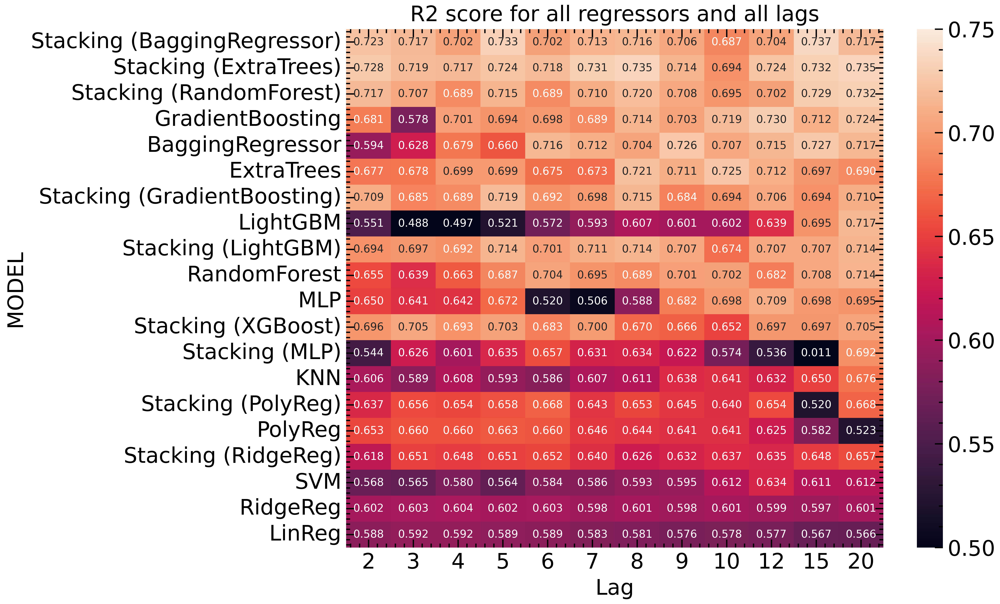

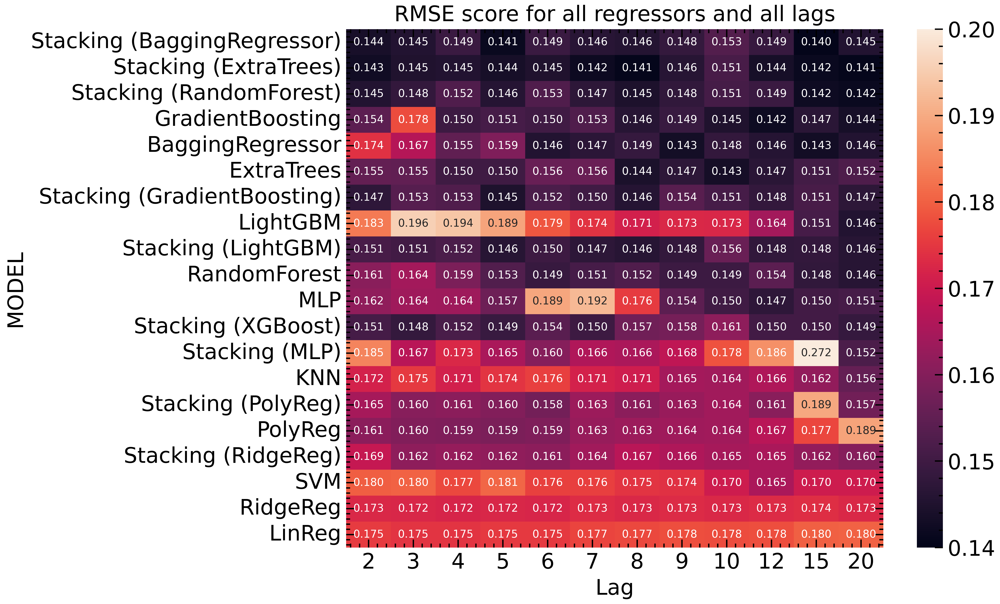

In [15]:
fig = plt.figure(figsize=(9,7))
sns.heatmap(data=df_r2.sort_values('max', ascending=False).iloc[:,:-2], annot=True, vmin=.5, vmax=.75, fmt='.3f')
plt.xlabel('Lag')
plt.title('R2 score for all regressors and all lags')

p = os.path.join(os.getcwd(), 'outputs', 'images_ensembles', '1_r2_order.eps',)
fig.savefig(p, format='eps')

fig = plt.figure(figsize=(9,7))
sns.heatmap(data=df_rmse.sort_values('min').iloc[:,:-2], vmin=0.14, vmax=.20, annot=True, fmt='.3f')
plt.xlabel('Lag')
plt.title('RMSE score for all regressors and all lags')

p = os.path.join(os.getcwd(), 'outputs', 'images_ensembles', '2_rmse_order.eps')
fig.savefig(p, format='eps')

pass;

In [16]:
df_rank = df.sort_values(by='R2_TEST_FS', ascending=False).drop_duplicates(subset=['MODEL']).reset_index()
df_rank.to_clipboard()
df_rank

,index,CLASS,MODEL,ORDER,R2_TRAIN_OSA,R2_TEST_OSA,R2_TRAIN_FS,R2_TEST_FS,RMSE_TRAIN_OSA,RMSE_TEST_OSA,RMSE_TRAIN_FS,RMSE_TEST_FS,MODEL_OBJ
0,217,stacking,Stacking (BaggingRegressor),15,0.966586,0.875925,0.785273,0.736719,4.823825e-02,0.096317,0.122284,0.140305,SYSIDRegressor(estimator=StackingRegressor(cv=...
1,236,stacking,Stacking (ExtraTrees),20,0.912570,0.831819,0.775867,0.735276,7.802918e-02,0.112138,0.124934,0.140689,SYSIDRegressor(estimator=StackingRegressor(cv=...
2,234,stacking,Stacking (RandomForest),20,0.918587,0.839225,0.769589,0.731839,7.529660e-02,0.109641,0.126672,0.141599,SYSIDRegressor(estimator=StackingRegressor(cv=...
3,187,ensemble,GradientBoosting,12,0.928488,0.880961,0.755299,0.729730,7.056930e-02,0.094343,0.130541,0.142155,SYSIDRegressor(estimator=RandomizedSearchCV(cv...
4,209,ensemble,BaggingRegressor,15,0.967123,0.898827,0.761770,0.726733,4.784944e-02,0.086975,0.128803,0.142941,SYSIDRegressor(estimator=RandomizedSearchCV(cv...
5,168,ensemble,ExtraTrees,10,0.972990,0.902221,0.766747,0.724987,4.336972e-02,0.085504,0.127450,0.143397,SYSIDRegressor(estimator=RandomizedSearchCV(cv...
6,75,stacking,Stacking (GradientBoosting),5,0.887697,0.824990,0.756851,0.719250,8.843498e-02,0.114392,0.130126,0.144885,SYSIDRegressor(estimator=StackingRegressor(cv=...
7,230,ensemble,LightGBM,20,0.963551,0.913698,0.738694,0.716520,5.038150e-02,0.080329,0.134897,0.145588,SYSIDRegressor(estimator=RandomizedSearchCV(cv...
8,78,stacking,Stacking (LightGBM),5,0.890459,0.823171,0.764718,0.714190,8.734070e-02,0.114984,0.128004,0.146185,SYSIDRegressor(estimator=StackingRegressor(cv=...
9,226,ensemble,RandomForest,20,0.933121,0.887793,0.737574,0.713824,6.824543e-02,0.091595,0.135186,0.146278,SYSIDRegressor(estimator=RandomizedSearchCV(cv...


In [17]:
df_rank.groupby(by=['MODEL'])['R2_TEST_FS'].max().sort_values(ascending=False)

MODEL
Stacking (BaggingRegressor)    0.736719
Stacking (ExtraTrees)          0.735276
Stacking (RandomForest)        0.731839
GradientBoosting               0.729730
BaggingRegressor               0.726733
ExtraTrees                     0.724987
Stacking (GradientBoosting)    0.719250
LightGBM                       0.716520
Stacking (LightGBM)            0.714190
RandomForest                   0.713824
MLP                            0.709196
Stacking (XGBoost)             0.705357
Stacking (MLP)                 0.692103
KNN                            0.675835
Stacking (PolyReg)             0.668464
PolyReg                        0.662723
Stacking (RidgeReg)            0.656606
SVM                            0.634136
RidgeReg                       0.603847
LinReg                         0.592395
Name: R2_TEST_FS, dtype: float64

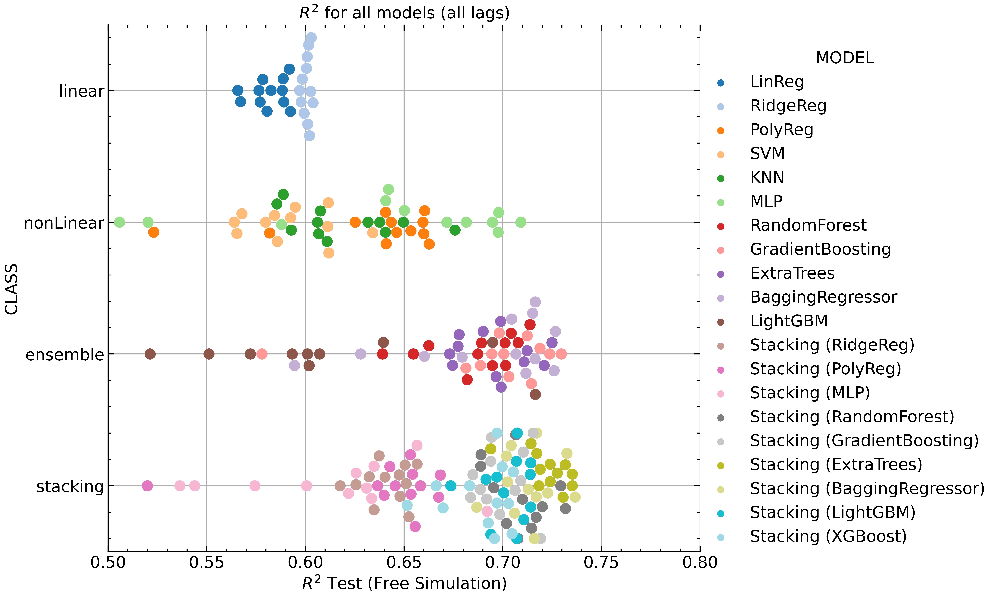

In [177]:
catplot = sns.catplot(data=df, y='CLASS', x='R2_TEST_FS', hue='MODEL', kind='swarm', height=8, aspect=1.3, s=120, palette='tab20')
plt.xlim((.5,.8))
plt.grid()
plt.xlabel('$R^2$ Test (Free Simulation)')
plt.title('$R^2$ for all models (all lags)')
pass;

fig = catplot.fig
p = os.path.join(os.getcwd(), 'outputs', 'images_ensembles', '3_r2_swarm.eps')
fig.savefig(p, format='eps')

In [51]:
sns.catplot(data=df, y='MODEL', x='R2_TEST_FS', hue='CLASS', kind='point', col='ORDER', col_wrap=3, height=7)
plt.xlim((.5,.8))

(0.5, 0.8)

In [61]:
lim=(.5,.8)
fig, ax = plt.subplots(4,3, figsize=(21,24))
ax = ax.flatten()

# fig.suptitle('Stacking Models \n (Base Estimators = Linear/Non Linear Models)', fontsize='20')

for i,o in enumerate (orders):
# for i,o in enumerate (orders[:-2]):
    sns.scatterplot(data=df[df['ORDER']==o], x='R2_TRAIN_FS', y='R2_TEST_FS', hue='CLASS', s=200, ax=ax[i]);
    ax[i].plot(lim, lim, '--', c='k')
    ax[i].set_xlim(lim)
    ax[i].set_ylim(lim)
    ax[i].set_title(f'Lag:{o}')
    ax[i].set_xlabel(f'$R^2$ FS (Train)')
    ax[i].set_ylabel(f'$R^2$ FS (Test)')
pass;

p = os.path.join(os.getcwd(), 'outputs', 'images_ensembles', '4_results_scatter.eps')
fig.savefig(p, format='eps')

In [ ]:
best_pred = df_rank.loc[0,'MODEL_OBJ'].predict(X1_te, y=y_te)

Plot multiple models, best from each class

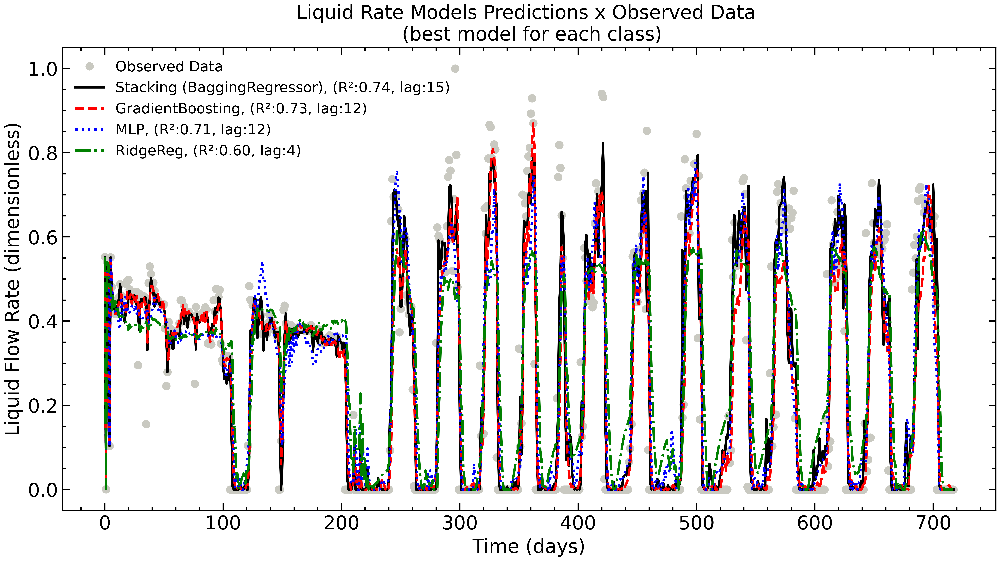

In [154]:
fig = plt.figure(figsize=(14,7))
plt.plot(y_te, 'o', label='Observed Data', c='#c9c9c1')

# plot some models, chose in array
for m in [0, 3, 10, 18]:
    testModel = df_rank.loc[m,'MODEL_OBJ']
    y_pred = testModel.predict(X1_te, y=y_te).clip(0)  
    plt.plot(y_pred, label=f"{df_rank.loc[m,'MODEL']}, (R²:{df_rank.loc[m,'R2_TEST_FS']:.2f}, lag:{df_rank.loc[m,'ORDER']})")
    plt.legend()

plt.ylabel('Liquid Flow Rate (dimensionless)')
plt.xlabel('Time (days)')
plt.legend(fontsize='12', loc='upper left')
plt.title('Liquid Rate Models Predictions x Observed Data \n (best model for each class)')
pass;

p = os.path.join(os.getcwd(), 'outputs', 'images_ensembles', '5_predictions_multiple.eps')
fig.savefig(p, format='eps')


Plot best model predictions

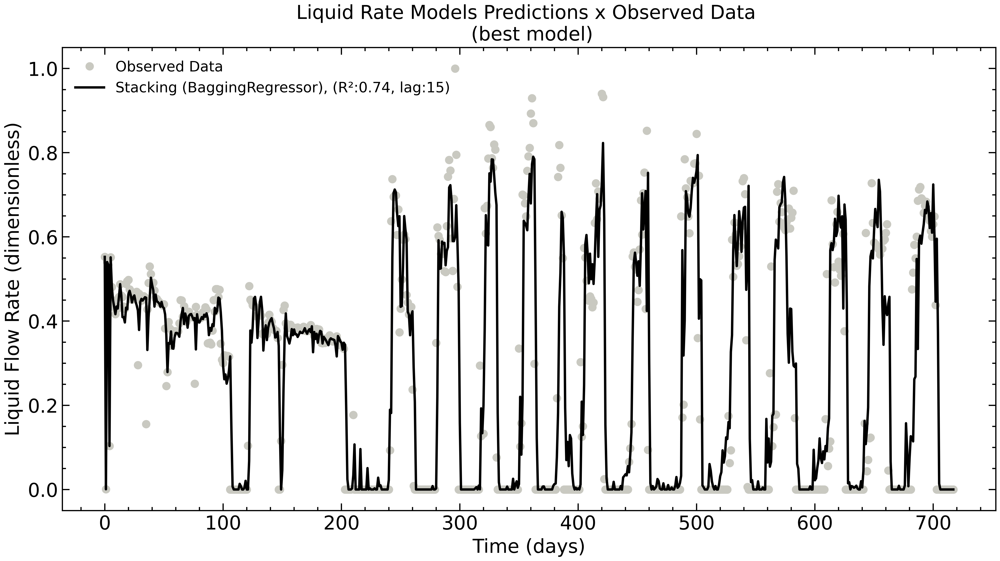

In [153]:
fig = plt.figure(figsize=(14,7))
plt.plot(y_te, 'o', label='Observed Data', c='#c9c9c1')

# plot best modl predictions
plt.plot(best_pred, label=f"{df_rank.loc[0,'MODEL']}, (R²:{df_rank.loc[0,'R2_TEST_FS']:.2f}, lag:{df_rank.loc[0,'ORDER']})")
plt.legend()

plt.ylabel('Liquid Flow Rate (dimensionless)')
plt.xlabel('Time (days)')
plt.legend(fontsize='12', loc='upper left')
plt.title('Liquid Rate Models Predictions x Observed Data \n (best model)')
pass;

p = os.path.join(os.getcwd(), 'outputs', 'images_ensembles', '6_predictions_best.eps')
fig.savefig(p, format='eps')

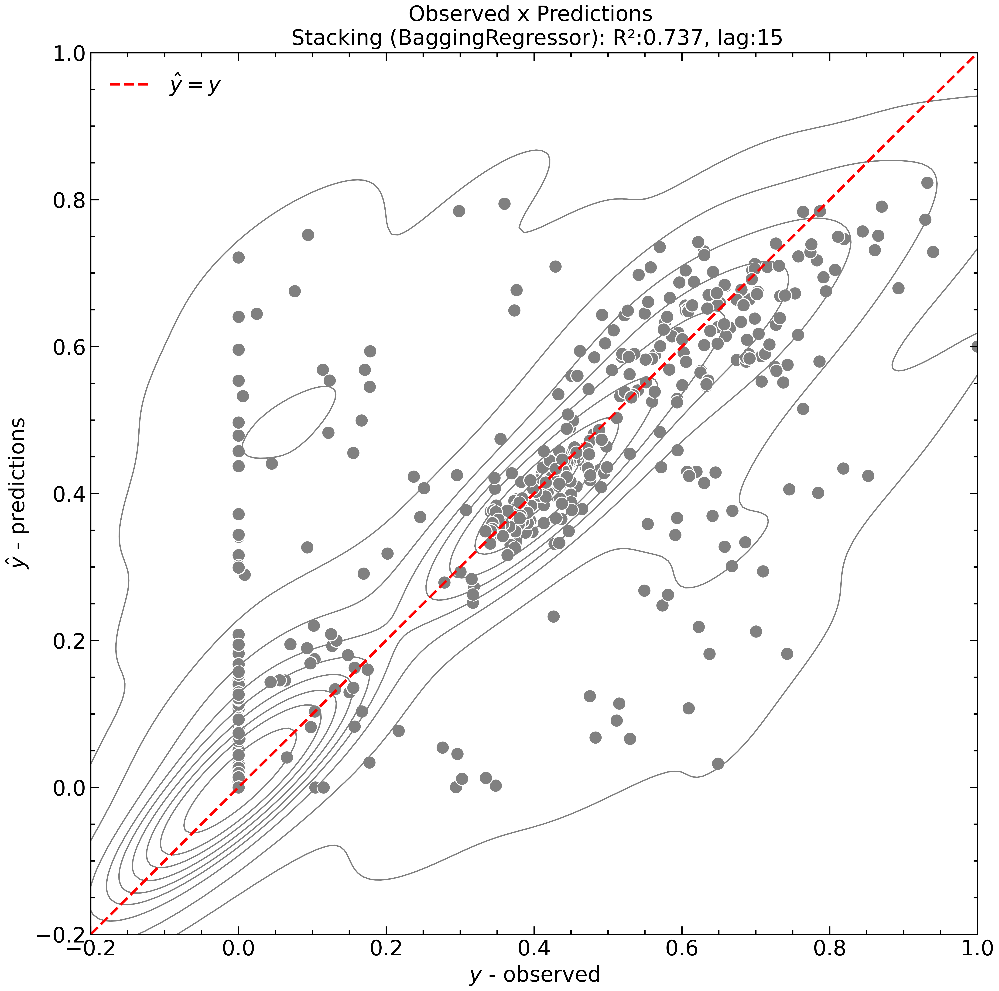

In [160]:
fig = plt.figure(figsize=(12,12))
lim =(-.2,1)

sns.scatterplot(x=y_te.ravel(), y=best_pred.ravel(), s=100, color='.5')
sns.kdeplot(x=y_te.ravel(), y=best_pred.ravel(), levels=10, linewidths=1, thresh=0.01, color='grey')

plt.plot(lim, lim, 'r--', label='$\hat{y}=y$')
plt.xlim(lim)
plt.ylim(lim)

plt.xlabel('$y$ - observed')
plt.ylabel('$\hat{y}$ - predictions')

plt.legend(loc='upper left')

plt.title(f"Observed x Predictions \n {df_rank.loc[0,'MODEL']}: R²:{df_rank.loc[0,'R2_TEST_FS']:.3f}, lag:{df_rank.loc[0,'ORDER']}")

p = os.path.join(os.getcwd(), 'outputs', 'images_ensembles', '7_crossplot_y_yhat.eps')
fig.savefig(p, format='eps')

pass;

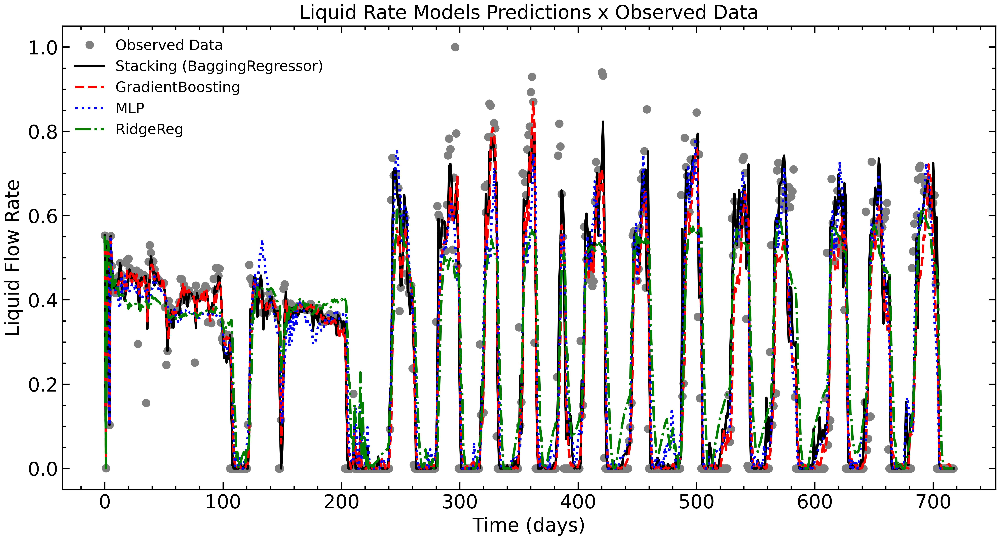

In [ ]:
fig = plt.figure(figsize=(14,7))
plt.plot(y_te, 'o', label='Observed Data', c='grey')

for m in [0,3,10,18]:
    testModel = df_rank.loc[m,'MODEL_OBJ']
    y_pred = testModel.predict(X1_te, y=y_te).clip(0)    
    plt.plot(y_pred, label=f"{df_rank.loc[m,'MODEL']}")
    # plt.plot(y_pred, label=f"{df_rank.loc[m,'MODEL']}, R²={df_rank.loc[m,'R2_TEST_FS']:.3f}, lag={df_rank.loc[m,'ORDER']}", )
    plt.legend()

plt.ylabel('Liquid Flow Rate')
plt.xlabel('Time (days)')
plt.legend(fontsize='12', loc='upper left')
plt.title('Liquid Rate Models Predictions x Observed Data')
pass;

p = os.path.join(os.getcwd(), 'outputs', 'images_ensembles', '3_rmse_order.eps')
fig.savefig(p, format='eps')


In [377]:
prefix = 'ENSV5B.MISO.W1'
binary = os.path.join(os.getcwd(), 'outputs', f'{prefix}_ml.pkl')
print(binary)

with open(binary, 'wb') as bin_file:
    pickle.dump((X1_tr, y_tr, X1_te, y_te, order_progression2, df), bin_file)

c:\Users\bewm\Documents\Projetos\Mestrado\SYSID_Trabalho\Volve-Dataset\outputs\ENSV5B.MISO.W1_ml.pkl
